## data viz - 3d project

***  
Team: Patrick McDevitt

***


### This portion of the script maps the features onto the t-SNE domain


*** 

### 02_tsne_features_mapping.ipynb

*** 

#### inputs:   

* nominal full data set :  
    * data_dir = '../data/'  
    * data_file = 'mashable_clean_dataset_for_lab_03.csv' 
* t1-t2-t3 vectors from t-SNE dimension reduction  
    * ./data/saved_csvs/2018.04.08_clusters/t_sne_mapping_perplex_datetime.csv  

#### function :  

* joins t1-t2-t3 vectors by indices to full data set for feature evaluation  
* performs k-means cluster analysis (scikit-learn)  over a range of number of clusters , as defined within  
* maps features from original data set into the t1-t2 vector space with appropriate labels  
* produces visualizations for interpretation  

#### output :  
    
* maps of all features in t1-t2-t3 mapped space with labels, boxplots distributions  

*** 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#%matplotlib inline
import warnings
warnings.simplefilter('ignore',DeprecationWarning)
import seaborn as sns
import time
import copy
import math

from pylab import rcParams
#import hdbscan

from ggplot import *

from sklearn.model_selection import ShuffleSplit
from sklearn.preprocessing import StandardScaler

#from sklearn.datasets import make_blobs

from sklearn.ensemble import RandomForestClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_score

from sklearn import metrics
from sklearn import metrics as mt
from sklearn.metrics import log_loss
from sklearn.metrics import accuracy_score as acc
from sklearn.metrics import confusion_matrix as conf
from sklearn.metrics import f1_score, precision_score, recall_score, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_fscore_support as score

from sklearn.cluster import KMeans

from tabulate import tabulate

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from __future__ import print_function

/home/mcdevitt/anaconda3/lib/python3.6/site-packages/ggplot/utils.py:81: FutureWarning: pandas.tslib is deprecated and will be removed in a future version.
You can access Timestamp as pandas.Timestamp
  pd.tslib.Timestamp,
/home/mcdevitt/anaconda3/lib/python3.6/site-packages/ggplot/stats/smoothers.py:4: FutureWarning: The pandas.lib module is deprecated and will be removed in a future version. These are private functions and can be accessed from pandas._libs.lib instead
  from pandas.lib import Timestamp
/home/mcdevitt/anaconda3/lib/python3.6/site-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


#### Read in cleaned  dataset from .csv file  

In [14]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... read in cleaned data set
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

data_dir = '../data/'
data_file = 'mashable_clean_dataset_for_lab_03.csv'

file_2_read = data_dir + data_file
df = pd.read_csv(file_2_read)

df_cluster = copy.deepcopy(df)

df_cluster.head()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... add 'popular' binary based 'shares' values
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

df_cluster['shares'] = np.exp(df_cluster['ln_shares'])

df_cluster['popular'] = np.where(df_cluster['shares'] > np.median(df_cluster['shares']), 1, 0)

df_cluster.head()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... read in t-SNE vectors
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

data_dir = '../data/saved_csvs/2018.04.08_clusters/'
data_file = 't_sne_3D_mapping_perplex_0075_20180408_231449.csv'

file_2_read = data_dir + data_file
df_tsne = pd.read_csv(file_2_read)

df_tsne.head()

,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,global_subjectivity,global_rate_positive_words,rate_positive_words,...,ln_self_reference_avg_sharess,ln_LDA_00,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares
0,0.757447,-1.164821,0,1,0,-0.112902,0,0.670593,0.346403,0.457827,...,-0.139965,1.320242,1.235123,-0.643623,-0.631127,-0.692339,-0.266190,0.100486,0.248162,-1.171081
1,-0.661657,-1.688626,0,0,0,-0.112902,0,-0.875228,0.201534,0.269096,...,-2.032745,2.255159,-0.413498,-0.597044,-0.592009,-0.647786,-0.080881,-0.937038,-0.740381,-0.976042
2,-0.661657,-0.641015,0,0,0,-0.112902,0,2.218418,0.989601,0.920026,...,0.047434,0.248240,-0.510740,-0.674579,-0.666507,1.573640,-0.660825,0.100486,-0.740381,-0.173712
3,-0.661657,-0.117210,0,1,0,-0.112902,0,-0.115874,0.103648,-0.081405,...,-2.032745,-0.619381,1.412882,1.105693,-0.686387,-0.744975,0.386392,0.640207,-0.740381,-0.413529
4,1.230482,-0.117210,0,0,0,-0.112902,0,0.601046,2.008329,0.936179,...,0.423196,-0.619083,-0.537434,-0.696925,-0.687885,2.111239,-0.412983,-0.937038,-0.005038,-1.343719


,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,global_subjectivity,global_rate_positive_words,rate_positive_words,...,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares,shares,popular
0,0.757447,-1.164821,0,1,0,-0.112902,0,0.670593,0.346403,0.457827,...,1.235123,-0.643623,-0.631127,-0.692339,-0.266190,0.100486,0.248162,-1.171081,0.310032,0
1,-0.661657,-1.688626,0,0,0,-0.112902,0,-0.875228,0.201534,0.269096,...,-0.413498,-0.597044,-0.592009,-0.647786,-0.080881,-0.937038,-0.740381,-0.976042,0.376799,0
2,-0.661657,-0.641015,0,0,0,-0.112902,0,2.218418,0.989601,0.920026,...,-0.510740,-0.674579,-0.666507,1.573640,-0.660825,0.100486,-0.740381,-0.173712,0.840539,1
3,-0.661657,-0.117210,0,1,0,-0.112902,0,-0.115874,0.103648,-0.081405,...,1.412882,1.105693,-0.686387,-0.744975,0.386392,0.640207,-0.740381,-0.413529,0.661312,0
4,1.230482,-0.117210,0,0,0,-0.112902,0,0.601046,2.008329,0.936179,...,-0.537434,-0.696925,-0.687885,2.111239,-0.412983,-0.937038,-0.005038,-1.343719,0.260874,0


,x-tsne,y-tsne,z-tsne,sample_index
0,2.975636,-0.071471,-2.679867,25473
1,0.116096,-0.547081,-4.582153,3824
2,1.617175,1.049166,-2.911772,22335
3,-0.003051,-4.168267,-3.908934,27345
4,0.657508,3.545489,0.171559,13277


In [3]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... join t-sne vectors with base data, since we sampled to create
# ...     the t-sne mapping
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

df_join = df_tsne.join(df_cluster, on = 'sample_index')

df_join.head()


,x-tsne,y-tsne,z-tsne,sample_index,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,...,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares,shares,popular
0,1.705787,-0.430726,-1.837001,25473,1.703516,-0.117210,1,0,0,-0.224451,...,-0.538703,-0.696755,-0.687416,-0.741509,0.272411,-0.671513,0.146348,2.390249,10.916213,1
1,0.210622,1.347502,1.574043,3824,0.757447,-0.117210,0,0,0,-1.032108,...,-0.538682,-0.696885,-0.687864,1.715036,-0.665015,0.100486,-0.740381,-0.327505,0.720719,0
2,0.687055,-1.590217,-1.388987,22335,-1.134691,-0.641015,0,0,0,1.168465,...,-0.510733,-0.674407,-0.665948,0.129984,-0.175414,0.100486,-0.740381,0.880405,2.411877,1
3,2.518085,0.767550,2.920529,27345,-0.188622,-0.117210,0,0,0,-0.107707,...,0.079032,-0.696880,0.248665,0.438044,0.885893,0.640207,-0.459723,-0.327505,0.720719,0
4,0.092572,1.115835,-3.058608,13277,-0.188622,1.454206,0,1,0,-0.945059,...,0.851537,0.240830,0.470015,-0.784381,0.773062,-0.937038,1.591996,1.843450,6.318297,1


In [16]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
# ... store joined data set in ../data/ directory
# ... write as .csv file for future recall
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=

perplex = 75

data_dir = '../data/saved_csvs/2018.04.08_clusters/'
data_file_base = "t_sne_3D_mapping_perplex_"
data_file_num = "%04d_joined" %perplex
data_file_ext = ".csv"
file_2_write = data_dir + data_file_base + data_file_num + data_file_ext

print(file_2_write)

df_join.to_csv(file_2_write, index = False)


../data/saved_csvs/2018.04.08_clusters/t_sne_3D_mapping_perplex_0075_joined.csv


In [4]:

col_names = df_join.columns.values.tolist()
col_names
df_join.describe().T


['x-tsne',
 'y-tsne',
 'z-tsne',
 'sample_index',
 'n_tokens_title',
 'num_keywords',
 'data_channel_is_lifestyle',
 'data_channel_is_entertainment',
 'data_channel_is_socmed',
 'kw_avg_max',
 'is_weekend',
 'global_subjectivity',
 'global_rate_positive_words',
 'rate_positive_words',
 'max_positive_polarity',
 'min_negative_polarity',
 'max_negative_polarity',
 'title_sentiment_polarity',
 'abs_title_subjectivity',
 'ln_n_tokens_content',
 'ln_num_hrefs',
 'ln_num_imgs',
 'ln_num_videos',
 'ln_kw_min_min',
 'ln_kw_avg_min',
 'ln_kw_min_max',
 'ln_kw_avg_avg',
 'ln_self_reference_avg_sharess',
 'ln_LDA_00',
 'ln_LDA_01',
 'ln_LDA_02',
 'ln_LDA_03',
 'ln_LDA_04',
 'ln_global_rate_negative_words',
 'ln_min_positive_polarity',
 'ln_abs_title_sentiment_polarity',
 'ln_shares',
 'shares',
 'popular']

,count,mean,std,min,25%,50%,75%,max
x-tsne,13875.0,-0.010936,2.198408,-5.533642,-1.717691,-0.026917,1.758123,5.283017
y-tsne,13875.0,-0.045316,2.036523,-5.623785,-1.557402,-0.022524,1.483729,4.619373
z-tsne,13875.0,-0.011935,2.602714,-6.360002,-1.833991,-0.050625,1.929728,6.141324
sample_index,13875.0,19843.906450,11465.838868,1.000000,9944.000000,19703.000000,29753.000000,39633.000000
n_tokens_title,13875.0,0.002399,1.000830,-3.972899,-0.661657,-0.188622,0.757447,5.960828
num_keywords,13875.0,-0.012449,1.001597,-3.260042,-0.641015,-0.117210,0.930401,1.454206
data_channel_is_lifestyle,13875.0,0.051243,0.220501,0.000000,0.000000,0.000000,0.000000,1.000000
data_channel_is_entertainment,13875.0,0.179892,0.384111,0.000000,0.000000,0.000000,0.000000,1.000000
data_channel_is_socmed,13875.0,0.058811,0.235279,0.000000,0.000000,0.000000,0.000000,1.000000
kw_avg_max,13875.0,0.014661,0.996129,-1.909059,-0.633407,-0.092884,0.550451,4.335148


In [5]:

X_all_together = copy.deepcopy(df_join)

len(X_all_together)


13875

In [6]:
col_names = X_all_together.columns.values.tolist()


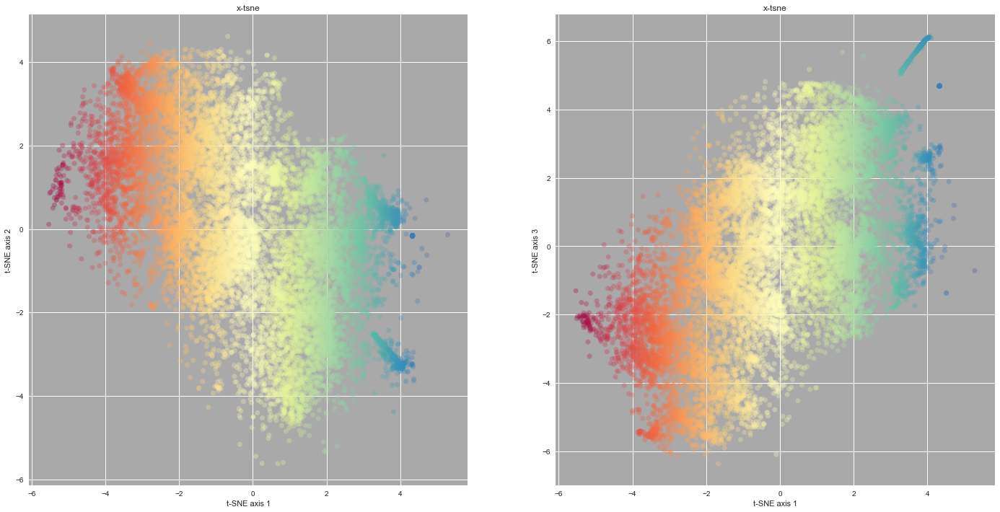

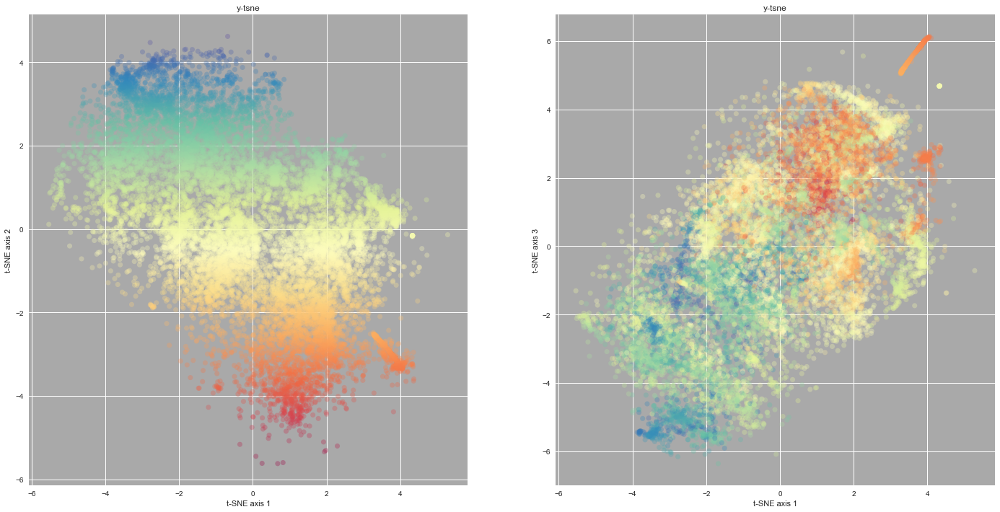

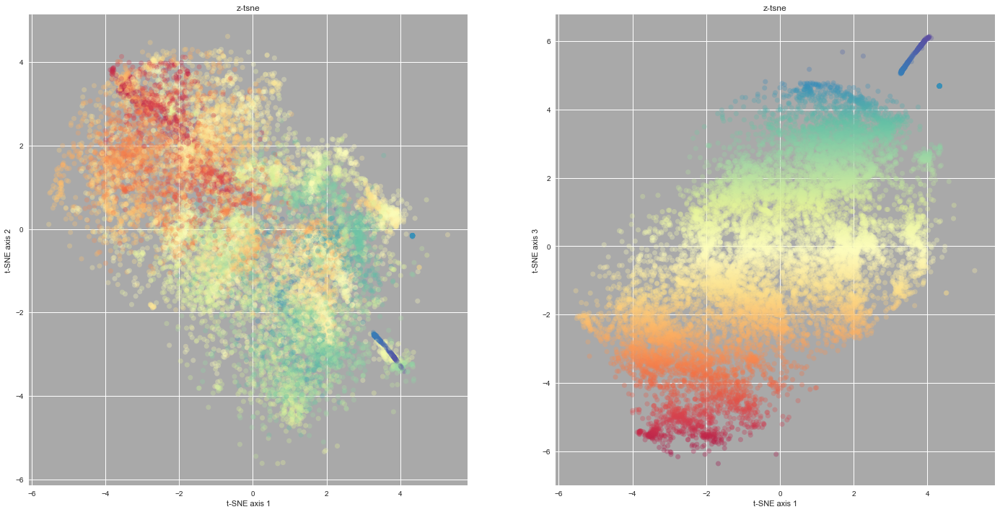

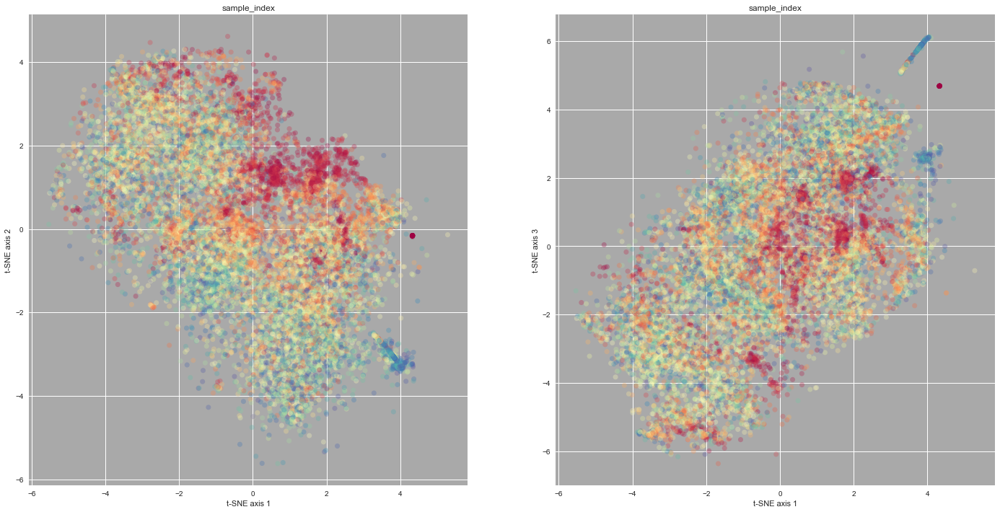

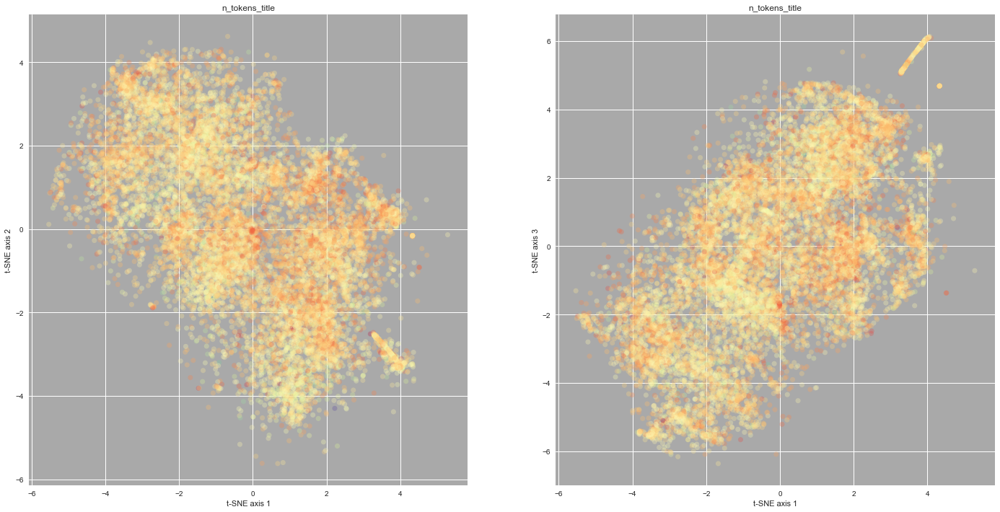

...

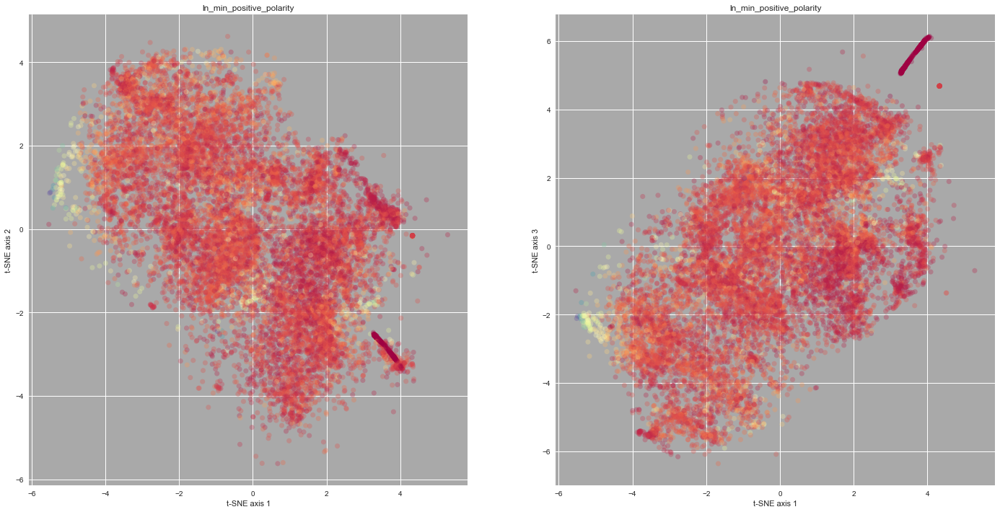

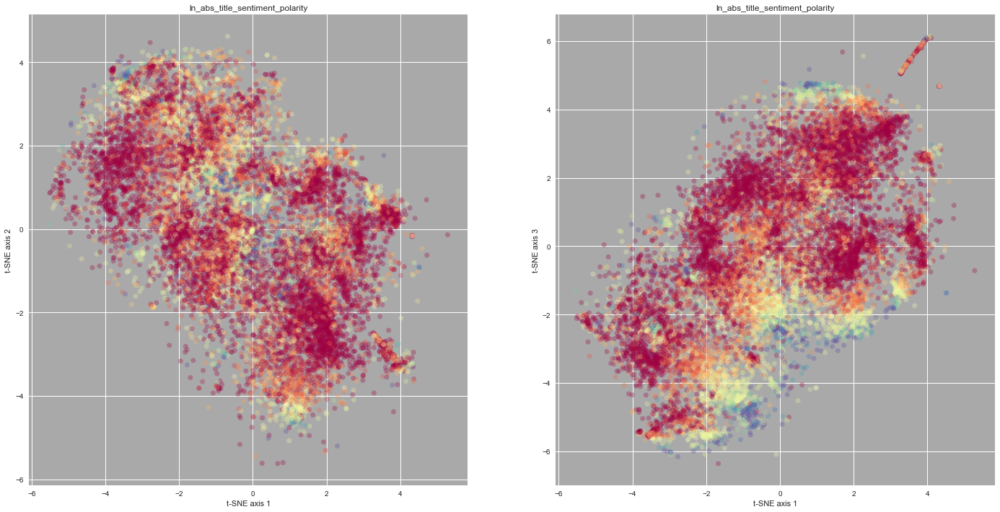

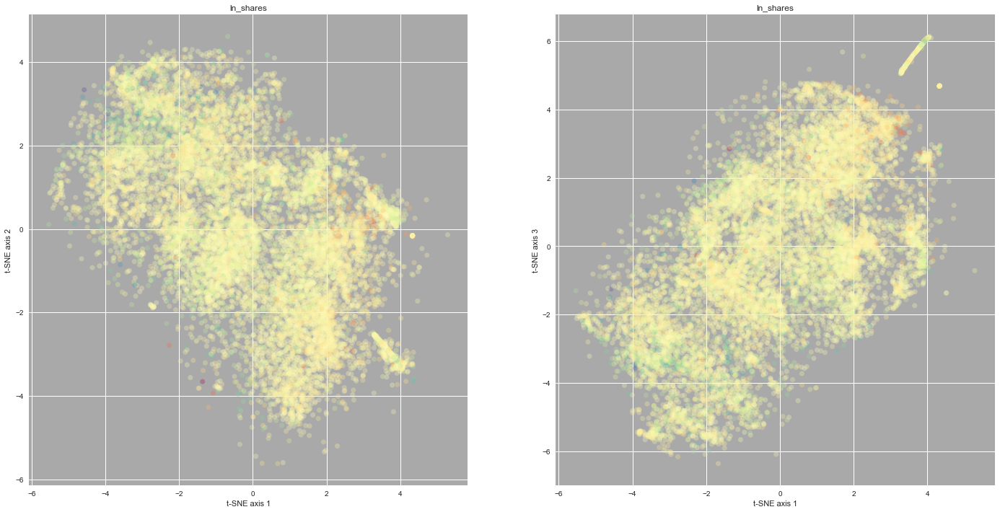

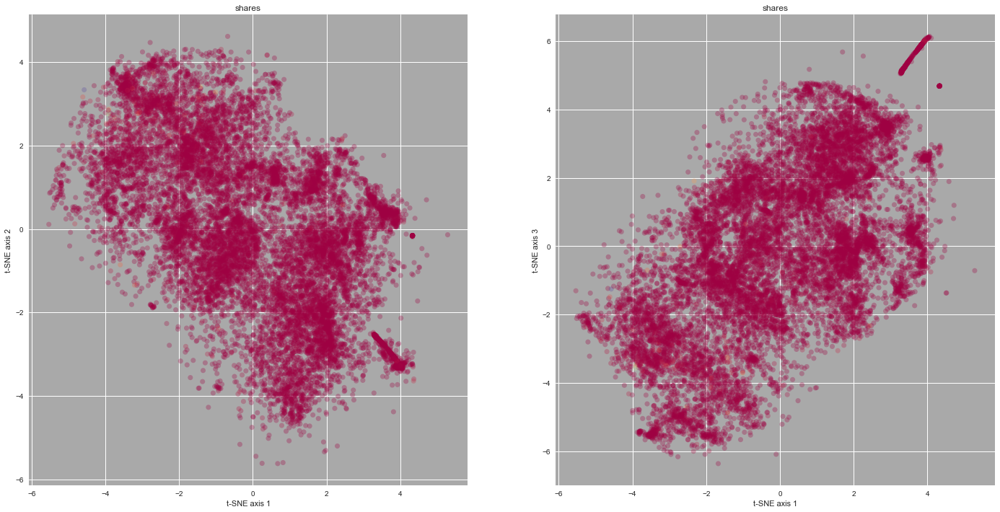

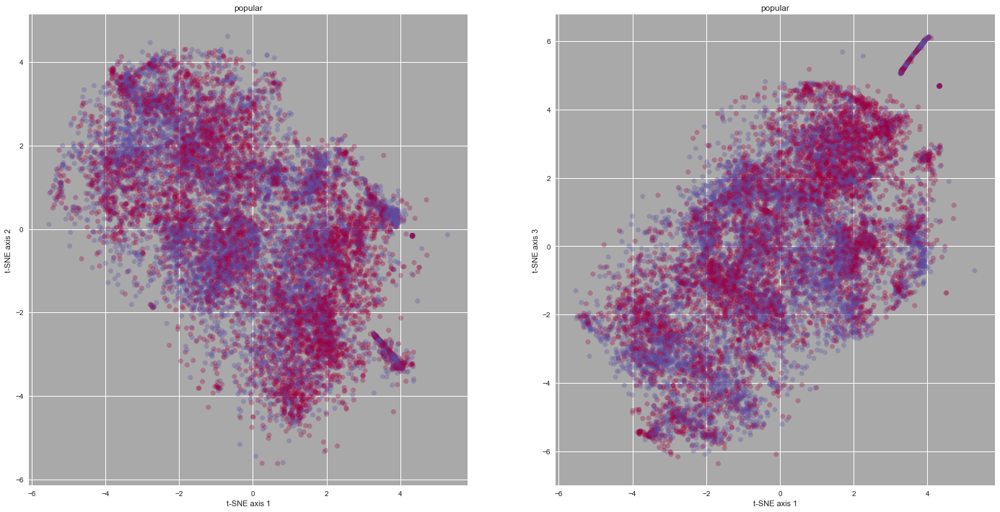

In [17]:
# boxplot across clusters for each feature ...
import seaborn as sns

col_names = X_all_together.columns.values.tolist()

for col in col_names :
    
    _ = plt.figure(figsize=(24, 12));
    
# ... feature distribution color map 

    # ... t1-t2

    _ = plt.subplot(121, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.title(col)
            
    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2')
    
    # ... t1-t3
        
    _ = plt.subplot(122, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['z-tsne'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.title(col)
            
    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 3')

    
    plt.savefig("../plots/tsne_3D_feature_map_perplx_075_%s.png" %col)
 
    _ = plt.show();
    

<a href='#toc'> Table of Contents</a>

<a name='end_of_file'></a>
<font color="blue" size=3>  end of file